In [25]:
!pip3 install pandas_profiling --upgrade

     |████████████████████████████████| 256kB 6.7MB/s 
     |████████████████████████████████| 81kB 6.2MB/s 
     |████████████████████████████████| 645kB 9.0MB/s 
     |████████████████████████████████| 112kB 20.0MB/s 
     |████████████████████████████████| 3.1MB 11.5MB/s 
     |████████████████████████████████| 61kB 5.3MB/s 
     |████████████████████████████████| 10.1MB 22.4MB/s 
     |████████████████████████████████| 1.1MB 30.5MB/s 
     |████████████████████████████████| 296kB 31.4MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp37-none-any.whl size=27085 sha256=c5e21cce26371841b32ce12d80f4136e12d57739653ee0e2954fa597716ad889
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
  Created wheel for phik: filename=phik-0.11.2-cp37-none-any.whl size=1107413 sha256=57c1bdcb7ae0f2114b9edc714a641ac8fbd43ec21181795ed7b32b73b1eec842
  Stored in directory: /root/.cache/pip/wheels/c0/a3/b0/f27b1cfe32ea131a3715169132ff6d8565

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport

In [2]:
fname = '/content/drive/MyDrive/Colab Notebooks/data/Tweets.csv'
df = pd.read_csv(fname)

In [3]:
profile = ProfileReport(df, title='Twitter summary', )

In [4]:
profile.to_widgets()

/usr/local/lib/python3.7/dist-packages/pandas_profiling/profile_report.py:410: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  "Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60)."


Summarize dataset:   0%|          | 0/28 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

## Make a word cloud of possitive and negative sentiments

In [15]:
import re
from wordcloud import WordCloud, STOPWORDS

In [16]:
positive_tweets = df[df['airline_sentiment']=='positive']['text']
negative_tweets = df[df['airline_sentiment']=='negative']['text']
neutral_tweets = df[df['airline_sentiment']=='neutral']['text']

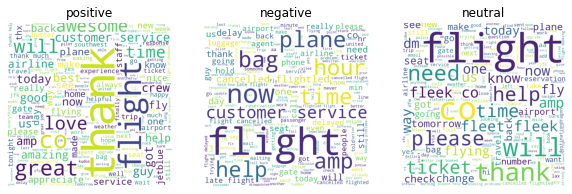

In [24]:
def topicWordCloud(series):
    comment_words = ''
    stopwords = set(STOPWORDS)
    # iterate through the csv file
    for val in series:
        # typecaste each val to string
        val = str(val)
        # remove twitter handle
        val = re.sub('@[^\s]+','',val)
        # split the value
        tokens = val.split()
        # Converts each token into lowercase
        for i in range(len(tokens)):
            tokens[i] = tokens[i].lower()
          
        comment_words += " ".join(tokens)+" "
    wordcloud = WordCloud(width = 800, height = 800,
            background_color ='white',
            stopwords = stopwords,
            min_font_size = 10).generate(comment_words)

    return wordcloud

sentiment = {'positive':positive_tweets,'negative':negative_tweets,'neutral':neutral_tweets}
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(10,10))
counter = 0
for title, tweets in sentiment.items():
    wordcloud = topicWordCloud(tweets)
    ax[counter].title.set_text(title)
    
    ax[counter].imshow(wordcloud)
    ax[counter].axis('off')
    counter += 1



  
plt.show()

__Notes__

- Remove the word flight 
- Looks of redundent word, but also some words that are enlightening. 
- "g"'s are with positive sentiment 
- "thank " corresponds to neutral and positive tweets
- asking for help seems to be a neutral sentiment - makes sense. 